In [ ]:
!pip install interpret wandb -qq scikit-optimize

# Explainable Boosting Machine (EBM)

First, import some basic libraries & define a couple of util functions to be used later for data loading and preprocessing

In [1]:
## Set up Gdrive to work with Colab
root_path = ""

if 'google.colab' in str(get_ipython()):
    from google.colab import drive
    root_path = "/content/drive/MyDrive/ml-seminar/data/"
    drive.mount("/content/drive")
else:
    root_path = "./data/"

print(root_path)

./data/


In [ ]:
## Unmount Gdrive
drive.flush_and_unmount()
print('All changes made in this colab session should now be visible in Drive.')

In [2]:
import wandb 
wandb.login()
#wandb.init(project="interpretable-ml", group="ebm-studies")

wandb: Currently logged in as: m-janyellow. Use `wandb login --relogin` to force relogin


True

In [15]:
# import basic libraries
import pandas as pd
from interpret.glassbox import ExplainableBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
from datetime import datetime
%matplotlib inline

## Define some basic helper and preprocessing functions

In [4]:
# Define data loader
def data_loader(data_path, pickle=True, parse_dates=False):
    # To-Do: include date parsing and set index to date/permno
    if not pickle:
      if parse_dates:
        dateparse = lambda x: pd.to_datetime(x, format='%Y-%m-%d', errors='coerce')
        data = pd.read_csv(root_path + data_path, index_col=["date","permno"],
                           parse_dates=['date'], date_parser=dateparse, skipinitialspace=True)
      else:
        data = pd.read_csv(root_path + data_path)
    else:
      data = pd.read_pickle(root_path + data_path)
    return data

In [22]:
subsample_path = 'subsample_processed_scaled.csv'
subsample = data_loader(subsample_path, pickle=False, parse_dates=True)
#subsample.shape

In [19]:
# Load full dataset with multiindex enabled
fullsample_path = 'data_processed_scaled.csv'
#data = data_loader(fullsample_path, pickle=False, parse_dates=True)
#data.shape

In [7]:
def normalize_target(data):
    scaler = StandardScaler()
    target = data.TARGET.values.reshape(-1, 1)
    #print(target.shape)
    data['TARGET'] = scaler.fit_transform(target)
    return data

In [13]:
## Inspect target vbl
import random
#subsample.TARGET.describe()
permnos_total = subsample.index.droplevel(['date'])
sample_permno = random.choice(permnos_total) # ramdom stock selected

# get and inspect distribution of target of that one
single_stock = subsample.xs(sample_permno, level='permno')
single_stock.TARGET.describe()

count    122.000000
mean       0.016346
std        0.096397
min       -0.234043
25%       -0.040069
50%        0.010845
75%        0.068303
max        0.438849
Name: TARGET, dtype: float64

In [10]:
def feature_selector(data, selectors):
    return data.loc[:,selectors]

## Simple Train / test split

Split data only once into train, valid and test set

In [8]:
def data_splitter(data, end_of_training="1985-12-31", end_of_validation="1990-12-31"):
    # define start of training
    start_of_training = data.index.get_level_values(0).min()
    
    # isolate y from data set
    X = data.iloc[:,:-1]
    y = data.TARGET
    
    # define initial training and test window
    train_window = pd.date_range(start=start_of_training, end=end_of_training, freq="M")
    train_window = len(train_window)

    # slice to required size
    X_train = X.loc[pd.IndexSlice[start_of_training:end_of_training,], :]
    y_train = y.loc[pd.IndexSlice[start_of_training:end_of_training,]]
    X_valid = X.loc[pd.IndexSlice[end_of_training:end_of_validation,], :]
    y_valid = y.loc[pd.IndexSlice[end_of_training:end_of_validation,]]
    X_test = X.loc[pd.IndexSlice[end_of_validation:,], :]
    y_test = y.loc[pd.IndexSlice[end_of_validation:,]]
    
    return X_train, X_valid, X_test, y_train, y_valid, y_test

### Hyperparameter tuning
(https://towardsdatascience.com/bayesian-optimization-for-hyperparameter-tuning-how-and-why-655b0ee0b399)

In [14]:
# Lets try Bayesian search first
X_train, X_test, _, y_train, y_test, _ = data_splitter(subsample)

from skopt import BayesSearchCV
from datetime import datetime

In [15]:
# Bayesian Search for hyperparm tuning
n_iter = 10

param_grid = {
    "learning_rate": (0.0001, 0.1, "log-uniform"),
    "max_rounds": (3000, 4000,  5000, 6000) ,
    "early_stopping_rounds": (30, 50),
    "max_bins": (128, 256),
    "early_stopping_tolerance" : (0.00001, 0.01, "log-uniform")
}

reg_bay = BayesSearchCV(estimator=ExplainableBoostingRegressor(random_state=0, n_jobs=-1),
                    search_spaces=param_grid,
                    n_iter=n_iter,
                    cv=5,
                    n_jobs=8,
                    scoring='neg_mean_squared_error',
                    random_state=0)

start_time = datetime.now()

# Run Bayes Search (this takes a while)
#model_bay = reg_bay.fit(X_train, y_train)

execution_time = (datetime.now() - start_time).total_seconds()
print(f"Optimization took {np.round(execution_time/60),2} minutes.")

Optimization took (0.0, 2) minutes.


In [ ]:
# model_bay
#X_train, X_test, _, y_train, y_test, _ = data_splitter(subsample)

# model can be saved, used for predictions or scoring
best_parms = model_bay.best_params_
best_score = model_bay.best_score_
best_estimator = model_bay.best_estimator_
cv_results = model_bay.cv_results_
print(f"Best params are: {best_parms} \n with best score of {best_score} ")

Best params are: OrderedDict([('early_stopping_rounds', 37), ('early_stopping_tolerance', 0.00020919480782183626), ('learning_rate', 0.000609840586504895), ('max_bins', 230), ('max_rounds', 3000)]) 
 with best score of -0.012216270250622302 


In [9]:
# fixed best parms identified by bayessearch and experiments and rounded them
best_parms_0 = dict([('early_stopping_rounds', 37), ('early_stopping_tolerance', 0.00021), 
                    ('learning_rate', 0.00061), ('max_bins', 230), ('max_rounds', 3000)])

best_params_1 = dict([('early_stopping_rounds', 37), ('early_stopping_tolerance', 0.00020919480782183626), 
                     ('learning_rate', 0.000609840586504895), ('max_bins', 230), ('max_rounds', 3000)])

## Train / test split

Split data into train and test sets using slicing (like in https://towardsdatascience.com/time-series-from-scratch-train-test-splits-and-evaluation-metrics-4fd654de1b37). <br/>

Set sizes according to Freyberger et al, 2019 (p.2356):

Train size: 1965 to 1979
Test size: 1980 to 1990

Prediction of 1-month-ahead returns (i.e. from Jan 1991 on)

Iterately refit once a year + increase training set for one year (according to Gu et al, 2019, p.2249)

In [ ]:
#%%script false --no-raise-error
start_of_training = data.index.get_level_values(0).min()
end_of_training, end_of_validation = "1975-12-31", "1985-12-31"
validation_window = 12 # 1 year / 12 mth

# define initial training and test window
train_window = pd.date_range(start=start_of_training, end=end_of_training, freq="M")
train_window = len(train_window)

# slice to required size
X_train_val = X.loc[pd.IndexSlice[start_of_training:end_of_validation,], :]
y_train_val = y.loc[pd.IndexSlice[start_of_training:end_of_validation,]]

# unique indices sorted for traversal
indices = X_train_val.index.unique(level='date')
# indices non-unique for masking
indices_val = X_train_val.index.get_level_values(0).to_numpy()


def validate_generator():
    """
    Generator for train and test set of out-of-sample predictions
    """

    train_window = pd.date_range(start=start_of_training, end=end_of_training, freq="M")
    train_window = len(train_window)

    for _ in indices:

        # define train window for given size, validation window directly follows afterwards with given length
        train_period = pd.date_range(start_of_training, periods=train_window, freq='M')
        validation_period = pd.date_range(train_period.max() + pd.offsets.MonthEnd(1), train_period.max() + pd.offsets.MonthEnd(validation_window))

        if validation_period.max() <= pd.to_datetime(end_of_validation):
            
            # create index mask for index selection
            train_array = list(np.where(np.isin(indices_val, train_period.to_numpy()))[0])
            validation_array = list(np.where(np.isin(indices_val, validation_period.to_numpy()))[0])
            
            #print(f"Train: {train_period.min()} - {train_period.max()} Validation: {validation_period.min()} - {validation_period.max()}")
            #print(f"Train: [{train_array[0]}-{train_array[-1]}] Validation: [{validation_array[0]}-{validation_array[-1]}]")

            # add validation data to next training set to obtain growing training window
            train_window += validation_window
            
            yield train_array, validation_array

# make generator non-exaustive
# see here: 
validate_gen = list(validate_generator())

NameError: name 'data' is not defined

In [ ]:
## Get train and valid sets for first split
# get train indices for first split
train_idss = validate_gen[0][0]
# slice data for first split
train = data.iloc[pd.IndexSlice[train_ids,]]

NameError: name 'validate_gen' is not defined

In [ ]:
print(train.index.min(), "\n",train.index.max())

(Timestamp('1963-07-31 00:00:00'), 19940) 
 (Timestamp('1975-12-31 00:00:00'), 68195)


In [ ]:
# get train indices for first split
valid_ids = validate_gen[0][1]
# slice data for first split
valid = data.iloc[pd.IndexSlice[valid_ids,]]
print(valid.index.min(), "\n",valid.index.max())

(Timestamp('1976-01-31 00:00:00'), 10006) 
 (Timestamp('1976-12-31 00:00:00'), 68195)


In [ ]:
#train.to_csv('./data/train_first.csv')
#valid.to_csv('./data/valid_first.csv')

In [ ]:
len(validate_gen) # there are 10 splits in total available until latest 1985

10

In [ ]:
# helper to isolate y from data set
def isolate_target(data):
    X = data.iloc[:,:-1]
    #print(X)
    y = data.TARGET
    return X, y

## Modelling (alternative)

In [ ]:
## First trial train an EBM on the first split

ebm = ExplainableBoostingRegressor()


def train_and_evaluate_ebm(train, valid):
    X_train, y_train = isolate_target(train) 
    X_test, y_test = isolate_target(valid)
    ebm.fit(X_train, y_train)
    valid_score = ebm.score(X_test, y_test)
    return ebm, valid_score

In [ ]:
print(isolate_target(train)[0].shape)
print(isolate_target(valid)[0].shape)

NameError: name 'train' is not defined

#### Wie sie sehen, sehen sie nichts...
- first run is catastophic
- shows the need for either hyperparameter tuning or feature selection!

In [ ]:
data.columns

Index(['cum_return_1_0', 'cum_return_6_2', 'cum_return_12_2',
       'cum_return_12_7', 'cum_return_36_13', 'investment', 'd_ceq', 'dpi2a',
       'd_shrout', 'ivc', 'noa', 'ato', 'cto', 'd_dgm_dsales', 'eps', 'ipm',
       'pcm', 'pm', 'pm_adj', 'prof', 'rna', 'roa', 'roc', 'roe', 'roic',
       's2c', 'sat', 'at_adj', 'aoa', 'ol', 'tan', 'oa', 'a2me', 'beme',
       'beme_adj', 'c', 'c2d', 'd_so', 'debt2p', 'e2p', 'free_cf', 'ldp',
       'nop', 'o2p', 'q', 's2p', 'sales_g', 'at', 'beta', 'beta_daily', 'dto',
       'idio_vol', 'lme', 'lme_adj', 'lturnover', 'rel_to_high_price',
       'ret_max', 'spread_mean', 'std_turn', 'std_volume', 'suv', 'total_vol',
       'ret', 'yy', 'mm_cos', 'mm_sin', 'stock', 'TARGET'],
      dtype='object')

In [ ]:
## Ok, lets randomly pick a subset of features to see if we can at least achieve reasonable performance

features = ['d_shrout', 'lme', 'lme_adj', 'lturnover', 'rel_to_high_price',
       'ret_max', 'spread_mean', 'std_turn', 'std_volume', 'suv', 'total_vol',
       'ret', 'yy', 'mm_cos', 'mm_sin', 'stock', 'TARGET']

train_random = train[features]
valid_random = valid[features]

ebm, score = train_and_evaluate_ebm(train_random, valid_random)
print(score)

-0.2906621707797341


In [ ]:
## even smaller 

features = ['d_shrout', 'lturnover','ret_max', 'ret', 'yy', 'mm_cos', 'mm_sin', 'stock', 'TARGET']

train_random = train[features]
valid_random = valid[features]

ebm, score = train_and_evaluate_ebm(train_random, valid_random)
print(score)

-0.29413658781479746


## Train and Validate Model

In [10]:
def train_model(model, X_train, y_train, tune=False, param_dict={}):
    if tune:
        print("model is being tuned")
        model.set_params(**param_dict)
    model.fit(X_train, y_train)
    return model

def validate_model(model, X_valid, y_valid):
    return model.score(X_valid, y_valid) # validation set R²

def rmse(y_test, y_pred):
    rmse_ = np.sqrt(((y_test - y_pred)**2).mean())  # np.sqrt(((predictions - targets) ** 2).mean())
    return rmse_

def visualize_ebm_global(ebm):
    from interpret import show
    ebm_global = ebm.explain_global()
    show(ebm_global) 

## Pipeline - bring it all together!

In [11]:
def pipeline(data_name, pickle, date_parse, 
             model=ExplainableBoostingRegressor(random_state=0), 
             tune=False, feature_selection=[], param_dict={}):
    # initialize wandb run for metric tracking
    wandb.init(project="interpretable-ml", group="ebm-studies")
    # start timer for total run time
    start_time = datetime.now()
    # consecutively run training steps
    data = data_loader(data_name, pickle, date_parse)
    if len(feature_selection)>=1:
      data = feature_selector(data, feature_selection) 
    data = normalize_target(data)
    X_train, X_valid, X_test, y_train, y_valid, y_test = data_splitter(data)
    fitted_model = train_model(model, X_train, y_train, tune, param_dict)
    # give global model explanations using built-in viz
    visualize_ebm_global(fitted_model)
    # get interesting metrics and attributes
    params = fitted_model.get_params()
    is_score = validate_model(model, X_train, y_train)
    oos_score = validate_model(model, X_valid, y_valid)
    y_pred = fitted_model.predict(X_valid)
    rmse_test = rmse(y_valid,y_pred)
    mse = mean_squared_error(y_valid, y_pred)
    mae = mean_absolute_error(y_valid,y_pred)
    n_features = X_train.shape[1]
    execution_time = (datetime.now() - start_time).total_seconds()
    wandb.log({"mse" : mse, "rmse" : rmse_test, "mae" : mae, "n_features": n_features, 
               "time_spent" : execution_time, "Model Params" : params})
    wandb.finish()
    return execution_time, is_score, oos_score, mae, mse, rmse_test, params, X_valid, y_valid, y_pred, fitted_model

In [23]:
### Helper method to visualize prediction vs true values
import matplotlib.pyplot as plt
import random
plt.style.use("seaborn")

permnos_total = subsample.index.droplevel(['date'])

def visualize_sample_prediction(y_test, y_pred):
    # Picks a random stock, to visualize its real returns 
    # against the predicted returns
    sample_permno = random.choice(permnos_total)
    ## delete:
    #sample_permno = 51625
    sample_test_y = y_test.xs(sample_permno, level='permno')
    
    sample_test_idx = sample_test_y.index.get_level_values('date')
    
    y_pred = pd.Series(y_pred, index=y_test.index)
    sample_pred = y_pred.xs(sample_permno, level='permno')
    
    
    fig,ax=plt.subplots(figsize=(18,6))

    ax.scatter(x=sample_test_idx, y= sample_test_y, color='r')
    ax.scatter(x=sample_test_idx, y= sample_pred, color='b')
    plt.title(f'Stock nr {sample_permno} predicted returns (blue) vs actual returns (red)')

### Round 1 - all features

In [16]:
pipe_run_1 = list(pipeline(subsample_path, pickle=False, date_parse=True, param_dict=best_params_1))

C:\Users\ASUS\anaconda3\envs\ml-seminar\lib\site-packages\interpret\visual\udash.py:5: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  import dash_html_components as html
C:\Users\ASUS\anaconda3\envs\ml-seminar\lib\site-packages\interpret\visual\udash.py:6: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  import dash_core_components as dcc
C:\Users\ASUS\anaconda3\envs\ml-seminar\lib\site-packages\interpret\visual\udash.py:7: UserWarning: 
The dash_table package is deprecated. Please replace
`import dash_table` with `from dash import dash_table`

Also, if you're using any of the table format helpers (e.g. Group), replace 
`from dash_table.Format import Group` with 
`from dash.dash_table.Format import Group`
  import dash_table as dt


<!-- http://127.0.0.1:7001/2542150267040/ -->

mae,▁
mse,▁
n_features,▁
rmse,▁
time_spent,▁
mae,0.66617
mse,0.94092
n_features,67
rmse,0.97001
time_spent,47.73743


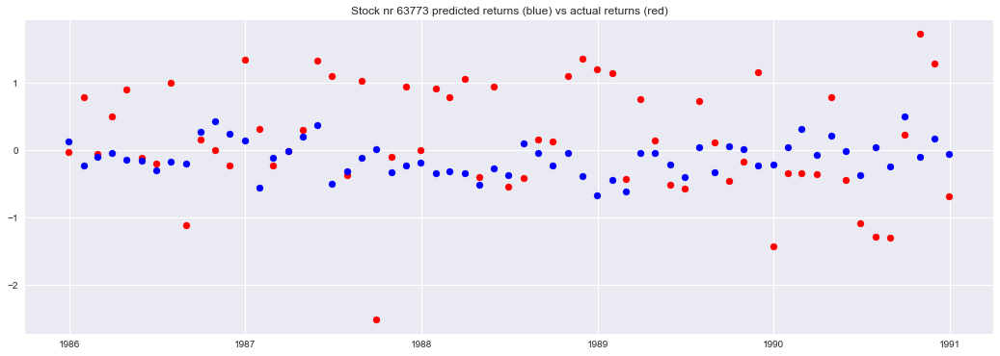

In [28]:
visualize_sample_prediction(pipe_run_1[-3], pipe_run_1[-2])

In [29]:
## Can we extract the learned functions??
X_valid = pipe_run_1[-4]
fitted_model = pipe_run_1[-1]
fct = fitted_model.decision_function(X_valid) # not sure what exactly this is doing...

In [45]:
y_pred = fitted_model.predict_and_contrib(X_valid) # this gives back a prediction and every features contribution (+some extra contribs?!)

In [53]:
## too many loops!!!
#for i in range(3):
#    for pred in y_pred[0]:
#        for contr in y_pred[1]:
#            print(f"Prediction: {pred} \n Feature contribution: {contr}")

Prediction: -0.11994481347299754 
 Feature contribution: [-0.00772512  0.00298738  0.00277334  0.01537987  0.00518606 -0.1354151
 -0.06467251  0.12973559 -0.01725872  0.00522488  0.02402049  0.01234131
 -0.03048588 -0.04179213 -0.0233155  -0.00188534  0.00189659  0.00769963
  0.1148789  -0.00380415 -0.01281616 -0.00056483 -0.00462252  0.0107048
 -0.01734479  0.03827248 -0.00296561 -0.00207948 -0.02620834  0.00118382
 -0.00049681  0.01228934 -0.02263785  0.0120168   0.04893707  0.00093487
  0.03333097 -0.03590273  0.05422494 -0.01069796 -0.00031465  0.01441859
 -0.00507186 -0.00947745 -0.00411255  0.01295858 -0.02019998 -0.02376893
  0.01297401  0.01873887 -0.00900345 -0.00243697 -0.0079858   0.00889679
 -0.02222562 -0.03701209  0.00721008  0.00376895 -0.01761299  0.01305332
 -0.00520202  0.00675574 -0.02805954 -0.00961161  0.19362521  0.16896127
 -0.0056561  -0.107922   -0.03899722 -0.19976833 -0.0390173  -0.041507
 -0.06646467  0.06262432  0.06617617 -0.08169791 -0.00304088]
Predictio

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: -0.11994481347299754 
 Feature contribution: [ 2.79907506e-02  2.72085115e-03  4.52579767e-03  7.75978671e-02
 -9.83652637e-04 -9.58716651e-02 -1.47371329e-02  2.12445114e-03
 -7.41096226e-02  6.58762304e-03  8.11732045e-03  1.79501216e-02
 -3.79187442e-03  1.27606233e-02  1.63702010e-04  4.98047279e-04
 -2.89510160e-02  1.68004940e-02  1.66339066e-02 -6.46854532e-03
  1.22234913e-02  4.31899587e-03 -1.58521980e-02  1.08568678e-02
 -1.85921061e-02  3.33212593e-02 -2.66235217e-02 -3.44170123e-02
 -2.67673202e-02  4.95646862e-03  5.75982606e-02 -4.69751953e-02
  2.76379493e-02 -2.71574510e-02  2.05521867e-02  1.86289472e-02
 -7.91374705e-03 -5.74989883e-02  2.47827976e-02 -3.61877547e-03
 -1.05971546e-02 -1.44900733e-02  6.12032049e-02  2.38849202e-02
 -1.12706276e-02  1.25727961e-02  1.78314839e-02 -3.02817980e-03
 -1.42859396e-02 -1.15565431e-02  2.99134774e-02  9.41083163e-03
 -2.78557368e-02 -2.24049010e-02  5.93574252e-02  1.41787266e-02
 -8.54495771e-03  1.78755153e-03

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: -0.11994481347299754 
 Feature contribution: [ 2.15480362e-03  1.02284160e-03  4.99368003e-03  1.34162019e-02
  6.73029016e-03  1.25967311e-02  8.26618314e-03  8.66581051e-03
  9.09134313e-02 -2.24198308e-02 -1.87825167e-02  1.37974209e-02
 -3.01353750e-03 -3.65870693e-02  1.95743072e-03  1.17689748e-02
 -1.27465477e-03  4.09530840e-02  6.02016909e-04  1.35748858e-02
 -1.80607199e-02  1.50219934e-02 -7.95804474e-03 -8.68117893e-02
 -3.04368251e-03 -5.09416509e-03 -2.83871629e-03  2.23844142e-03
  6.95887860e-04  4.04935833e-03  6.26866682e-02  1.97799963e-02
 -1.27759580e-02  1.15987717e-03 -4.09265744e-02 -8.05349235e-03
  5.97300699e-03 -6.77691206e-02  1.71938927e-02  5.51792225e-03
 -4.61924338e-03 -1.44900733e-02 -1.26591845e-02  1.24892114e-02
 -5.90032407e-03  8.96454062e-03 -8.52407771e-03 -1.27720915e-02
 -1.34339759e-02 -5.60528547e-03  4.25772940e-03 -4.07468443e-05
  3.01845544e-02  2.59389486e-02  4.59625137e-03 -5.58045837e-03
  1.57163471e-02 -5.78786672e-03

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: 0.44237022967690287 
 Feature contribution: [-0.05034516  0.00434757  0.01873478  0.02331969 -0.01091367 -0.1354151
  0.01205798  0.08281991 -0.25667158  0.00658762  0.02340288  0.03222884
  0.02820533 -0.03933269 -0.03481167  0.22372741 -0.02154679 -0.15665577
 -0.00854016  0.06358748  0.03955965  0.06034668 -0.00702525 -0.06189402
 -0.124931    0.03737977 -0.02218236  0.06433352  0.01790282 -0.00734128
 -0.05014122 -0.05108382 -0.01189665 -0.06113817 -0.09046658 -0.13702893
 -0.03429788  0.05916648 -0.0126376  -0.03764295  0.09920123 -0.01449007
 -0.01069762  0.03113289 -0.1108792  -0.03525694  0.00799624  0.0172923
 -0.00451985 -0.01384286 -0.01803661  0.02840071 -0.05919039  0.01684109
  0.01203364 -0.00160012 -0.0437589   0.00268254  0.00386764  0.02581478
 -0.00880433 -0.01586305  0.1174237  -0.00961161 -0.04322759 -0.02450742
 -0.02865239 -0.05538703 -0.03909859 -0.02566865 -0.02565018 -0.08035311
 -0.07435805  0.03974551 -0.06704731 -0.04947418 -0.03283256]
Predict

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: 0.44237022967690287 
 Feature contribution: [ 0.00079109 -0.01210154  0.0010992  -0.01793886 -0.00867345  0.01092147
 -0.01967133  0.01073981 -0.21361353  0.00790184  0.0246037  -0.00199189
  0.00528286  0.01449398 -0.01013646  0.01176897 -0.00111465  0.0172271
  0.01451579 -0.02704092  0.04159584 -0.00604505 -0.00795804  0.01159784
 -0.09352877  0.01178537  0.03874713 -0.03441364 -0.02676732 -0.07173731
  0.04565624 -0.04453691  0.02839015 -0.02715745 -0.0050041  -0.00966394
 -0.01243192 -0.00105631  0.03199302 -0.01342993  0.00122704 -0.01467624
 -0.00657988  0.02757166 -0.01098649 -0.00930416  0.00669984  0.02143024
  0.00538979  0.00852364  0.00625833  0.01773369 -0.03223694  0.02430529
  0.01546608 -0.01662495  0.00565495  0.00097395  0.02416213 -0.02149566
  0.00674252 -0.02458829 -0.02606089 -0.00961161  0.19362521  0.16896127
  0.00612442 -0.107922    0.04744682 -0.19976833 -0.03951117  0.08837434
 -0.06770229  0.05103123  0.06301523  0.0704308   0.02928451]
Predic

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: -0.3522585350456306 
 Feature contribution: [-0.01072969 -0.04355822 -0.00443227  0.09847423 -0.00042255  0.01059497
  0.01376697  0.01380367  0.03259917  0.0462241   0.02302668 -0.00692709
 -0.00196926 -0.0678932   0.00722111  0.00718836  0.00656235  0.01128058
  0.00778409 -0.01462678 -0.00246463 -0.00056483  0.02263703  0.01107772
  0.00161676  0.05332606 -0.03325174  0.06129317 -0.01964011 -0.00501603
  0.04038636  0.00566708 -0.02656348  0.02547525 -0.0211651  -0.00454436
 -0.01599978 -0.01439732 -0.00872479  0.00322713 -0.00031465  0.00621308
 -0.00507186  0.02513377 -0.00653403  0.0125728   0.00431175  0.03111583
  0.00439265 -0.00260984 -0.00560215  0.01203431 -0.028576   -0.03683321
  0.03924108 -0.0102325   0.01458961 -0.00289892 -0.00249586 -0.01240884
 -0.00880433 -0.01311507 -0.01095744 -0.00961161 -0.04322759 -0.02450742
 -0.04137218 -0.05538703 -0.00136507 -0.02566865  0.00845883 -0.06133609
 -0.02440819  0.00914905  0.26024699 -0.02367006 -0.05528668]
Predi

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Prediction: -0.3522585350456306 
 Feature contribution: [-1.06700038e-02 -1.61929465e-03  2.61776224e-02 -1.13997132e-02
  8.17958644e-03  9.36457623e-04  1.39008402e-02  8.38124475e-03
 -1.83329197e-02  2.49564046e-03  8.34688152e-03  5.82024764e-03
  8.10727942e-03 -3.87392842e-02 -1.82505834e-02  4.79880611e-03
  7.70527936e-03  2.61677167e-02  1.88429261e-02 -2.40243390e-02
 -2.50379984e-02 -1.49750841e-02 -2.69073590e-02  1.27677783e-02
  4.00877153e-05  4.03130328e-02 -7.92389958e-03 -2.50265999e-02
 -3.43295550e-02  3.74326675e-02 -8.48036037e-04 -3.48864985e-02
  3.99946406e-03  1.32344543e-02  4.64872352e-03 -1.38270556e-02
 -9.88553453e-03  1.71395489e-04 -3.24425484e-03  4.10400425e-03
 -1.19980887e-02 -1.86184566e-02 -3.73173098e-02 -2.03122119e-02
 -1.09400058e-02  1.20931215e-02  3.54823655e-03 -2.71014901e-02
  1.04316844e-02  8.51270945e-03  1.06445637e-02 -4.19197915e-03
 -3.93735980e-02  4.36724780e-03  1.93814215e-02  2.67153217e-02
  9.54570920e-03  2.10719893e-02 -

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: -0.3522585350456306 
 Feature contribution: [ 0.00950268  0.00087525  0.00693008  0.06985505  0.00764736  0.01092147
 -0.07232032  0.02269488 -0.11594817 -0.0182224   0.02643523  0.05078559
 -0.06872982 -0.03658707 -0.01262894 -0.0381019  -0.00111465  0.01139344
  0.01276669 -0.0149941  -0.01281616  0.06692617  0.01396116  0.02895866
  0.03258705  0.02936351 -0.000857   -0.01261901  0.01259257 -0.07173731
  0.00840773  0.0319018  -0.04538874 -0.02235404 -0.09893958 -0.00840699
 -0.02631823 -0.0127746   0.03408273 -0.03660339  0.02062177 -0.01449007
 -0.01424925  0.01248921  0.00444435 -0.01618891  0.00606782  0.1045663
  0.02174803  0.00455949  0.02393151  0.01872267 -0.05919039  0.02593895
  0.01552867  0.01434326 -0.03386104  0.01969887  0.00247571  0.0463604
  0.00190551  0.01507556 -0.19314341 -0.00961161  0.05113226 -0.00535546
  0.00189145 -0.02749316 -0.02291944 -0.12122455 -0.03012126  0.07975519
 -0.02438174  0.22492824  0.07294284  0.0672807  -0.02069287]
Predict

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Prediction: 0.05551416273927432 
 Feature contribution: [ 0.01262433  0.00909429  0.00100971 -0.01380606 -0.0208798  -0.00101436
  0.01775759  0.01834853  0.04946224  0.01149063  0.01499593 -0.03185296
  0.01471074 -0.03671867 -0.0018871  -0.00254081 -0.00111465  0.0172271
  0.03379506 -0.01035013 -0.00965373 -0.01522493  0.01396116  0.01085687
  0.00704672  0.03737977  0.01623036 -0.02505909  0.03250631 -0.02336339
 -0.0347216  -0.04422925 -0.04038544  0.00840631 -0.00537323  0.00943218
  0.08013207 -0.02353478 -0.00013    -0.00404332 -0.01061096 -0.01449007
 -0.00106559  0.01353265 -0.00593599 -0.01129713  0.00742885  0.01765274
  0.06942026 -0.00662715 -0.01424555 -0.00942604 -0.093591   -0.03372535
 -0.01528891 -0.00558046  0.01985487 -0.00499931  0.00666271  0.01654416
 -0.0105651  -0.00338662  0.02702878 -0.00961161  0.05113226 -0.00535546
 -0.00866333 -0.02749316 -0.01873396 -0.12122455 -0.00694518 -0.0827702
  0.01502721  0.04866048  0.04218981  0.12514321 -0.02069287]
Predict

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [40]:
idx = X_valid.index.droplevel(['permno'])
fct_df = pd.Series(data=fct).reindex(index=idx)

In [42]:
type(fct)

numpy.ndarray

In [39]:
print(fct_df.shape, " - ", fct.shape)

(13538,)  -  (13538,)


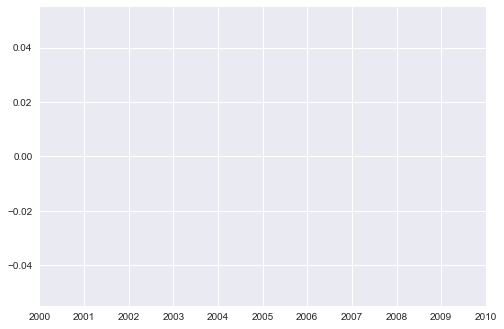

In [41]:
plt.plot(fct_df)

In [ ]:
print(f'Pipe took {pipe_run_1[0]} sec to execute. \n is R-squared : {pipe_run_1[1]} \n oos-R.squared : {pipe_run_1[2]} \n MAE : {pipe_run_1[3]}')

Pipe took 58.955221 sec to execute. 
 is R-squared : 0.32113192535783763 
 oos-R.squared : -0.058405504185536694 
 MAE : 0.6669353115941243


### hide

In [ ]:
## lets inspect the last 1000 predictions. What went wrong??
X_test = pipe_run[2]
y_test = pipe_run[3]
y_pred = pipe_run[4]

sample_test_x = X_test.iloc[-5000:,:]
sample_test_idx = sample_test_x.index.get_level_values('date')
sample_test_y = y_test.iloc[-5000:,]
sample_pred = y_pred[-5000:,]

In [ ]:
print(sample_test_idx.shape,
     sample_test_y.shape,
     sample_pred.shape)

(5000,) (5000,) (5000,)


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


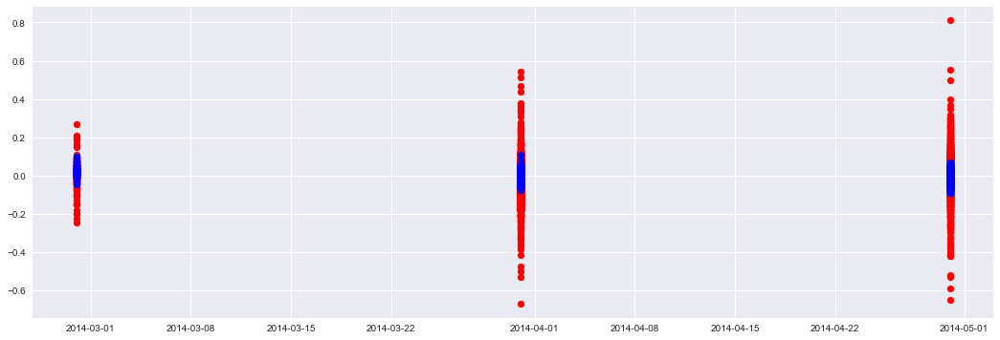

In [ ]:
import matplotlib.pyplot as plt
plt.style.use("seaborn")

fig,ax=plt.subplots(figsize=(18,6))

ax.scatter(x=sample_test_idx, y= sample_test_y, color='r')
#plt.plot(sample_pred, sample_test_y)
#plt.scatter(x=sample_test_idx, y= [sample_test_y], c='g')
ax.scatter(x=sample_test_idx, y= sample_pred, color='b')
ax.legend()

### Lets try it with less features

### Round 2 - features identified by RF

In [25]:
## best features found by random forrest reg
features_rf = ['d_shrout', 'roe', 'oa', 'free_cf', 'nop', 'dpi2a', 'rna', 'ato', 'd_dgm_dsales', 'roc', 'ipm', 'spread_mean', 'dto', 'suv', 'TARGET']

In [ ]:
pipe_run_2 = list(pipeline(subsample_path, pickle=False, date_parse=True, feature_selection=features_rf))

In [ ]:
## run with feat rf and tuned params
best_param_dict = dict(best_parms)
pipe_run_rf_1 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_rf, 
                           param_dict=best_param_dict))

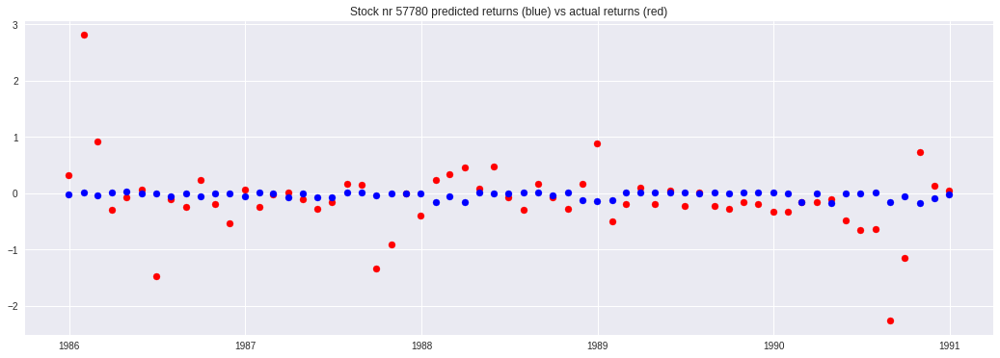

In [ ]:
visualize_sample_prediction(pipe_run_rf_1[-3], pipe_run_rf_1[-2])
plt.savefig(f'{root_path}/sample_pred_23_5')

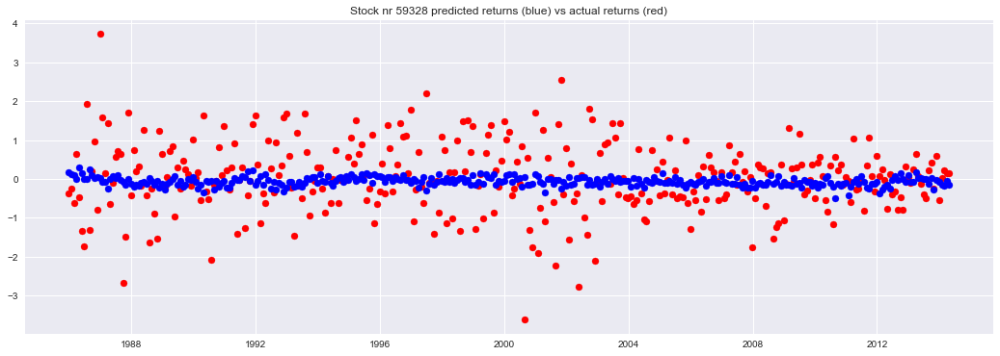

In [ ]:
visualize_sample_prediction(pipe_run_2[-3], pipe_run_2[-2])

MAE : 0.6696398064864569, MSE : 1.1048317568845858, RMSE: 1.0511097739458928


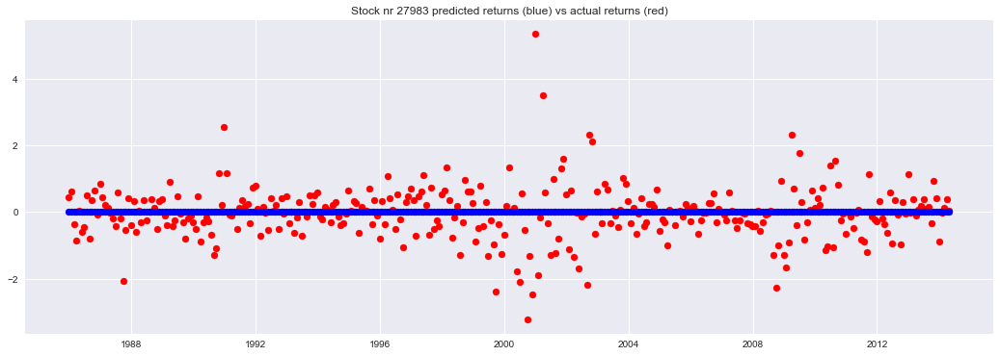

In [ ]:
y_true = pipe_run_2[-3]
zero_preds = np.zeros_like(y_true)

visualize_sample_prediction(y_true, zero_preds)
mae0 = mean_absolute_error(y_true, zero_preds)
mse0 = mean_squared_error(y_true, zero_preds)
rmse0 = rmse(y_true, zero_preds)
print(f"MAE : {mae0}, MSE : {mse0}, RMSE: {rmse0}")

In [30]:
pipe_run_rf_full = list(pipeline(fullsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_rf, 
                           param_dict=best_params_1))

now we're tuning
{'binning': 'quantile', 'early_stopping_rounds': 37, 'early_stopping_tolerance': 0.00020919480782183626, 'feature_names': None, 'feature_types': None, 'inner_bags': 0, 'interactions': 10, 'learning_rate': 0.000609840586504895, 'mains': 'all', 'max_bins': 230, 'max_interaction_bins': 32, 'max_leaves': 3, 'max_rounds': 3000, 'min_samples_leaf': 2, 'n_jobs': -2, 'outer_bags': 8, 'random_state': 0, 'validation_size': 0.15}


mae,▁
mse,▁
n_features,▁
rmse,▁
time_spent,▁
mae,0.63738
mse,0.8791
n_features,14
rmse,0.9376
time_spent,231.38831


### Round 3 - features used by Freyberger et al (2019)

In [32]:
## best features used by freyberger et al:
features_freyberger = ['d_shrout', 'd_so', 'investment', 'lme', 'lturnover', 'pm_adj', 'cum_return_1_0', 'cum_return_12_2', 'cum_return_12_7', 'rel_to_high_price', 'roc','suv', 'total_vol','TARGET']

In [ ]:
pipe_run_3 = list(pipeline(subsample_path, date_parse=True, pickle=False, feature_selection=features_freyberger))

In [ ]:
pipe_run_4 = list(pipeline(fullsample_path, date_parse=True, pickle=False, feature_selection=features_freyberger))

In [ ]:
print(f'Pipe took {pipe_run_3[0]} sec to execute. \n In-sample R-squared : {pipe_run_3[1]} \n Out-of-sample R-squared : {pipe_run_3[2]} \n RMSE : {pipe_run_3[3]}')

Pipe took 361.095627 sec to execute. 
 In-sample R-squared : 0.19095257277144195 
 Out-of-sample R-squared : -0.06397057223785163 
 RMSE : 1.0842085162558124


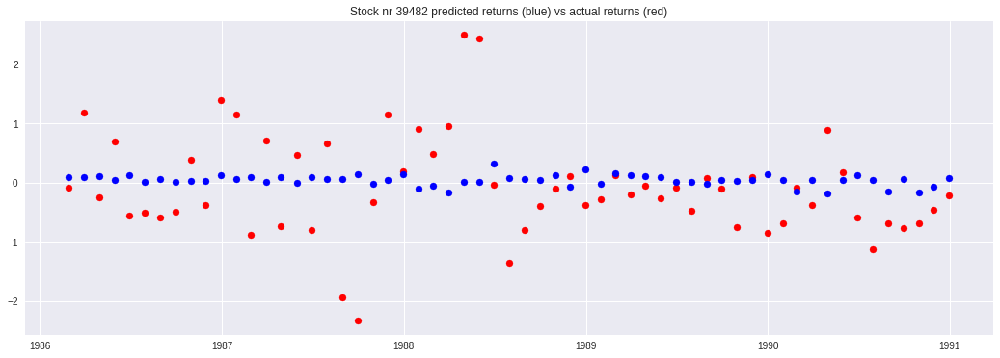

In [ ]:
visualize_sample_prediction(pipe_run_4[-3], pipe_run_4[-2])
plt.savefig(f'{root_path}/sample_pred_22_3')

In [ ]:
# freyberger feat on tuned params
best_param_dict = dict(best_parms)
pipe_run_4 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_freyberger, 
                           param_dict=best_param_dict))

In [35]:
# run it on whole data set
pipe_run_freyberger_full = list(pipeline(fullsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_freyberger, 
                           param_dict=best_params_1))

now we're tuning
{'binning': 'quantile', 'early_stopping_rounds': 37, 'early_stopping_tolerance': 0.00020919480782183626, 'feature_names': None, 'feature_types': None, 'inner_bags': 0, 'interactions': 10, 'learning_rate': 0.000609840586504895, 'mains': 'all', 'max_bins': 230, 'max_interaction_bins': 32, 'max_leaves': 3, 'max_rounds': 3000, 'min_samples_leaf': 2, 'n_jobs': -2, 'outer_bags': 8, 'random_state': 0, 'validation_size': 0.15}


mae,▁
mse,▁
n_features,▁
rmse,▁
time_spent,▁
mae,0.63828
mse,0.88354
n_features,13
rmse,0.93997
time_spent,220.34824


### Round 4 - features ae

In [42]:
features_ae = ['e2p', 'beme', 'cum_return_12_2', 'cum_return_12_7', 'mm_sin', 'mm_cos', 'yy', 'dpi2a', 'ret', 'total_vol', 'noa', 'std_volume', 'cto', 'TARGET']
#pipe_run_4 = list(pipeline(subsample_path, feature_selection=features_ae))

In [ ]:
pipe_run_ae_1 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_ae, 
                           param_dict=best_params_1))

In [47]:
pipe_run_ae = list(pipeline(fullsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_ae, 
                           param_dict=best_params_1))

now we're tuning
{'binning': 'quantile', 'early_stopping_rounds': 37, 'early_stopping_tolerance': 0.00020919480782183626, 'feature_names': None, 'feature_types': None, 'inner_bags': 0, 'interactions': 10, 'learning_rate': 0.000609840586504895, 'mains': 'all', 'max_bins': 230, 'max_interaction_bins': 32, 'max_leaves': 3, 'max_rounds': 3000, 'min_samples_leaf': 2, 'n_jobs': -2, 'outer_bags': 8, 'random_state': 0, 'validation_size': 0.15}


mae,▁
mse,▁
n_features,▁
rmse,▁
time_spent,▁
mae,0.63191
mse,0.85862
n_features,13
rmse,0.92662
time_spent,374.74735


### Round 5 - Few features

In [39]:
features_adhoc = ['yy', 'cum_return_12_7', 'ret', 'd_so', 'mm_sin', 'suv', 'd_shrout', 'mm_cos', 'rna', 'stock', 'TARGET']
features_few = ['yy',  'ret', 'mm_sin', 'd_shrout', 'mm_cos', 'stock', 'TARGET']

In [ ]:
pipe_run_adhoc_1 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_few, 
                           param_dict=best_parms_0))

In [ ]:
pipe_run_adhoc_1 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_few, 
                           param_dict=best_params_1))

In [ ]:
pipe_run_adhoc_2 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_adhoc, 
                           param_dict=best_params_1))

### Use Union of features from three selection methods (RF, freyberger, AE)

In [ ]:
# Without repetition 
def union(lst1, lst2, lst3):
    final_list = list(set(lst1) | set(lst2) | set(lst3))
    return final_list

In [ ]:
a = features_ae
b = features_freyberger
c = features_rf
features_comb = union(a,b,c)
features_comb.remove("TARGET")
print(features_comb)

['ato', 'yy', 'spread_mean', 'cum_return_12_7', 'ret', 'd_so', 'd_dgm_dsales', 'lturnover', 'roe', 'mm_sin', 'ipm', 'dpi2a', 'beme', 'nop', 'lme', 'suv', 'dto', 'noa', 'd_shrout', 'total_vol', 'free_cf', 'cum_return_1_0', 'mm_cos', 'roc', 'e2p', 'oa', 'cto', 'rna', 'pm_adj', 'std_volume', 'rel_to_high_price', 'cum_return_12_2', 'investment']


In [ ]:
features_combined = ['ato', 'yy', 'spread_mean', 'cum_return_12_7', 'ret', 'd_so', 'd_dgm_dsales', 'lturnover', 'roe', 'mm_sin', 'ipm', 'dpi2a', 'beme', 'nop', 'lme', 'suv', 'dto', 'noa', 'd_shrout', 'total_vol', 'free_cf', 'cum_return_1_0', 'mm_cos', 'roc', 'e2p', 'oa', 'cto', 'rna', 'pm_adj', 'std_volume', 'rel_to_high_price', 'cum_return_12_2', 'investment', 'TARGET']

In [ ]:
pipe_run_combined_1 = list(pipeline(subsample_path, date_parse=True, pickle=False,
                           tune=True, feature_selection=features_combined, 
                           param_dict=best_parms_0))

In [ ]:
from interpret import show
model = pipe_run_combined_1[-1]
show(model.explain_global())

## conclusion:

Using the union of features of the three methods did not improve but slitely decrease accuracy.
=> More features are not necessarily better.
=> More tuning does not help either 

**Two more ideas**

1) visualize results in an aggregated way: mean returns over all stocks per month e.g.

2) use only a few features, i.e. the top 3 of the above methods + returns (maximum)

A thought: standardize per stock not globally - would this change model performanee?

## Smoothen data

In [ ]:
# Smoothen time-series using rolling mean
def data_smoothener(data, window=3):
    data_smooth = data.groupby(data.index.get_level_values('permno')).rolling(window, center=False).mean()
    return data_smooth

In [ ]:
data_smooth = data_smoothener(subsample)

In [ ]:
print(data_smooth.isna().any().sum())

68


In [ ]:
data_smooth.dropna(inplace=True)
data_smooth.iloc[:,1].isna().sum()

0

ValueError: setting an array element with a sequence.

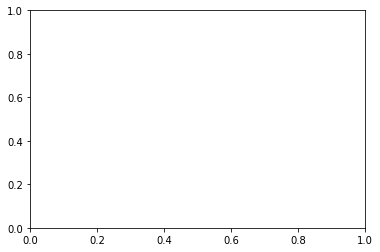

In [ ]:
import matplotlib.pyplot as plt
plt.plot(data_smooth['ret'])
#plt.plot(subsample)

## Stationarity test
Time series are oftentimes non-stationary meaning their statistical properties such as probability distribution, their mean and stddev change over time. Hence, using R² (which relies on these properties) to estimate the models performance can be misleading. [Source: <a href="https://www.youtube.com/watch?v=MN5AYymKDhc">yt</a>]. <br/>
<u> Test for stationarity </u> using augmented dickey fuller test: Nullhypothesis: Data has a unit root -> process which is non-stationary. If p-value > some threshold -> We cannot say the series is non-stationary. Otherwise, it is non-stationary [see https://en.wikipedia.org/wiki/Unit_root] <br/> 
Viable alternatives to R²:
- MAE
- MSE
- RMSE

In [ ]:
stationary_stocks = [24628, 45672, 32329]

In [ ]:
from statsmodels.tsa.stattools import adfuller
import random

## Conduct adfuller test for stationarity x times. Nullhypothesis: there is a unit root
permnos_total = subsample.index.droplevel(['date'])

for i in range(5):
    sample_permno = random.choice(permnos_total)
    sample_firm_data = subsample.xs(sample_permno, level='permno')
    
    # test whether price is stationary by applying the Augmented Dickey Fuller Test
    adf_test = adfuller(sample_firm_data['ret'])

    # Equals MacKinnon's approximate p-value based on MacKinnon
    p_vle = adf_test[1]
    if p_vle >= 0.05:
        stationary_stocks.append(sample_permno)
    
    print(f"Permno {sample_permno}. adfuller-test p value: {p_vle: .5f}")

Permno 39052. adfuller-test p value:  0.00000
Permno 30779. adfuller-test p value:  0.00000
Permno 82276. adfuller-test p value:  0.24633
Permno 45655. adfuller-test p value:  0.00000
Permno 15579. adfuller-test p value:  0.00000


<AxesSubplot:xlabel='date'>

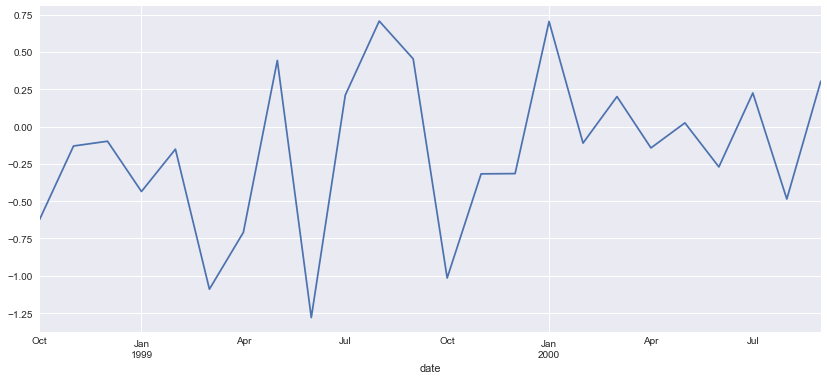

In [ ]:
## Inspect stock with p-value >= 5% (return could be stationary)
sample_permno = 82276
sample_data = subsample.xs(sample_permno, level='permno') 
plt.figure(figsize=(14,6))
sample_data['ret'].plot()

In [ ]:
stationary_stocks

[24628, 45672, 32329, 75550, 82276]

In [ ]:
idx = sample_data.index.get_level_values('date')
print(idx.min(), "\n",
      idx.max())

1998-10-31 00:00:00 
 2000-09-30 00:00:00


### Observation:
There are indeed a few probably stationary stocks (see above). Most of them appear to have limited data available though, e.g. just a few years. <br/>
Non-stationary stocks appear to be regular case in the available data though, which is why I rather shouldnt use R² for model evaluation 
[R² relies on the mean value of y (ground truth), see https://en.wikipedia.org/wiki/Coefficient_of_determination]

Instead, MAE, MSE or RMSE are suitable. Advantage of RMSE is that it is in the same unit of the target and therefor better interpretable than MSE [https://analyticsindiamag.com/a-guide-to-different-evaluation-metrics-for-time-series-forecasting-models/]

In [ ]:
## Attempt to plot metrics over time (adopted by Markus B.)
from sklearn.metrics import mean_squared_error, mean_absolute_error

# get indices for test set period
start_of_oos_test = "1990-12-31"
end_of_oos_test = subsample.index.get_level_values(0).max()
test_indices = pd.date_range(start_of_oos_test, end_of_oos_test, freq='M')

# define X_test
# slice to required size
X_test = subsample.loc[pd.IndexSlice[start_of_oos_test:end_of_oos_test,], :]

def plot_scores_over_time(pipe_run, test_indices=test_indices):
    # indices of whole test dataset
    indices_val = X_test.index.get_level_values(0).to_numpy()
    
    # visualize mae over time
    y_true = pd.Series(pipe_run[-3])
    y_pred = pd.Series(pipe_run[-2])
    
    scores = []
    
    for slice in test_indices:
            # create index mask
            test_array = list(np.where(np.isin(indices_val, slice))[0])
    
    for t in test_array:
        pred_ret = y_pred.iloc[t]
        true_ret = y_true.iloc[t]
        score_mse = mean_squared_error(true_ret, pred_ret)
        score_mae = mean_absolute_error(true_ret, pred_ret)
        scores.append((true_ret.index.min()[0],score_mse,score_mae))

    print(scores[0])

    scores_df = pd.DataFrame(scores, columns=['date','MSE', 'MAE'])
    scores_df = scores_df.set_index("date")
    scores_df

    scores_df.plot(title="MSE and MAE over time")